In [1]:
import numpy as np

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

from layers import Linear, Sigmoid, Sequential, ReLU
from optim import SGD
from loss import CrossEntropyLoss

import torch
from torch import optim, nn

from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split

%load_ext autoreload
%autoreload 2

In [2]:
X, y = load_iris(return_X_y=True)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

In [3]:
def train_model_torch(X_train, y_train, model, optimizer, criterion, num_epochs=50):
    for i in range(num_epochs):
        optimizer.zero_grad()
        pred = model(X_train)

        loss = criterion(pred, y_train)
        accuracy = calculate_accuracy_torch(pred, y_train)

        loss.backward()
        optimizer.step()

        print(f'Epoch: {i + 1} | Loss: {loss} | Accuracy: {accuracy}')

def calculate_accuracy_torch(y_pred, y_true):
    return torch.sum(torch.argmax(y_pred, axis = 1) == y_true) / y_pred.shape[0]

In [4]:
def train_model(X_train, y_train, model, optimizer, criterion, num_epochs=50):
    for i in range(num_epochs):
        optimizer.zero_grad()
        pred = model(X_train)

        loss, loss_grad = criterion(pred, y_train)
        accuracy = calculate_accuracy(pred, y_train)

        model.backward(loss_grad)
        optimizer.step()

        print(f'Epoch: {i + 1} | Loss: {loss} | Accuracy: {accuracy}')

def calculate_accuracy(y_pred, y_true):
    return np.sum(np.argmax(y_pred, axis = 1) == y_true) / y_pred.shape[0]

In [5]:
model = Sequential(
    Linear(4, 3),
    )
optimizer = SGD(model.parameters(), lr=1e-2)
criterion = CrossEntropyLoss()

In [6]:
train_model(X_train, y_train, model, optimizer, criterion, 5000)

Loss: 0.20193335540629617 | Accuracy: 0.9714285714285714
Epoch: 4719 | Loss: 0.2019125852638341 | Accuracy: 0.9714285714285714
Epoch: 4720 | Loss: 0.20189182163982958 | Accuracy: 0.9714285714285714
Epoch: 4721 | Loss: 0.20187106453119075 | Accuracy: 0.9714285714285714
Epoch: 4722 | Loss: 0.2018503139348278 | Accuracy: 0.9714285714285714
Epoch: 4723 | Loss: 0.20182956984765246 | Accuracy: 0.9714285714285714
Epoch: 4724 | Loss: 0.2018088322665787 | Accuracy: 0.9714285714285714
Epoch: 4725 | Loss: 0.20178810118852256 | Accuracy: 0.9714285714285714
Epoch: 4726 | Loss: 0.20176737661040148 | Accuracy: 0.9714285714285714
Epoch: 4727 | Loss: 0.20174665852913537 | Accuracy: 0.9714285714285714
Epoch: 4728 | Loss: 0.20172594694164594 | Accuracy: 0.9714285714285714
Epoch: 4729 | Loss: 0.20170524184485655 | Accuracy: 0.9714285714285714
Epoch: 4730 | Loss: 0.2016845432356928 | Accuracy: 0.9714285714285714
Epoch: 4731 | Loss: 0.20166385111108212 | Accuracy: 0.9714285714285714
Epoch: 4732 | Loss: 0.20

In [7]:
calculate_accuracy(model(X_test), y_test)

0.9777777777777777

In [8]:
model = nn.Sequential(
    nn.Linear(4, 3),
    )
optimizer = optim.SGD(model.parameters(), lr=1e-2)
criterion = nn.CrossEntropyLoss()

In [9]:
train_model_torch(torch.tensor(X_train).float(), torch.tensor(y_train).long(), model, optimizer, criterion, 5000)

: 0.19455954432487488 | Accuracy: 0.9714285731315613
Epoch: 4719 | Loss: 0.19453993439674377 | Accuracy: 0.9714285731315613
Epoch: 4720 | Loss: 0.1945202648639679 | Accuracy: 0.9714285731315613
Epoch: 4721 | Loss: 0.19450058043003082 | Accuracy: 0.9714285731315613
Epoch: 4722 | Loss: 0.19448089599609375 | Accuracy: 0.9714285731315613
Epoch: 4723 | Loss: 0.19446127116680145 | Accuracy: 0.9714285731315613
Epoch: 4724 | Loss: 0.19444169104099274 | Accuracy: 0.9714285731315613
Epoch: 4725 | Loss: 0.19442208111286163 | Accuracy: 0.9714285731315613
Epoch: 4726 | Loss: 0.19440235197544098 | Accuracy: 0.9714285731315613
Epoch: 4727 | Loss: 0.19438280165195465 | Accuracy: 0.9714285731315613
Epoch: 4728 | Loss: 0.19436323642730713 | Accuracy: 0.9714285731315613
Epoch: 4729 | Loss: 0.19434362649917603 | Accuracy: 0.9714285731315613
Epoch: 4730 | Loss: 0.1943240761756897 | Accuracy: 0.9714285731315613
Epoch: 4731 | Loss: 0.1943044513463974 | Accuracy: 0.9714285731315613
Epoch: 4732 | Loss: 0.19428

In [10]:
calculate_accuracy_torch(model(torch.tensor(X_test).float()), torch.tensor(y_test).long()).item()

0.9777777791023254

In [11]:
def colored_dots(y):
    colors = ("red", "blue")
    colored_y = np.zeros(y.size, dtype=str)

    for i, cl in enumerate([0,1]):
        colored_y[y == cl] = str(colors[i])
    return colored_y

In [12]:
def plot_graph(X, y):
    plt.figure(figsize=(15,10))
    plt.scatter(X[:, 0], X[:, 1], c=colored_dots(y))
    plt.show()

In [13]:
def plot_colored_graph(model, X, y, eps=0.1):
    plt.figure(figsize=(15,8))

    xx, yy = np.meshgrid(np.linspace(np.min(X[:,0]) - eps, np.max(X[:,0]) + eps, 200),
                        np.linspace(np.min(X[:,1]) - eps, np.max(X[:,1]) + eps, 200))
    Z = np.argmax(model(np.c_[xx.ravel(), yy.ravel()]), axis=1)
    Z = Z.reshape(xx.shape)
    cmap_light = ListedColormap(['#FFAAAA', '#AAAAFF'])
    plt.pcolormesh(xx, yy, Z, cmap=cmap_light)

    plt.scatter(X[:, 0], X[:, 1], c=colored_dots(y))

In [14]:
X, y = np.array([[1, 0], [1, 1], [0, 1], [0, 0]]), np.array([1, 0, 0, 1])

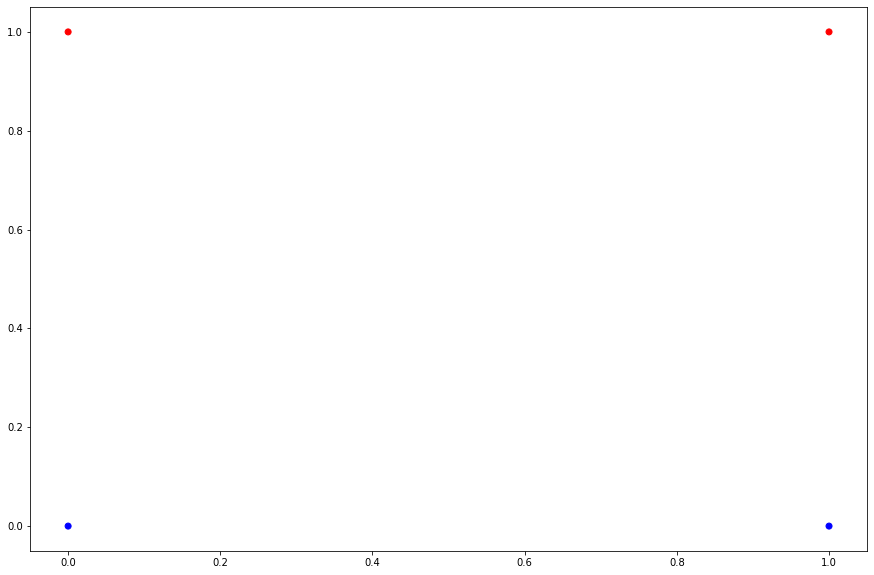

In [15]:
plot_graph(X, y)

In [16]:
model = Sequential(
    Linear(2, 2),
)
optimizer = SGD(model.parameters(), lr=5e-2, momentum=0.9)
criterion = CrossEntropyLoss()

In [17]:
train_model(X, y, model, optimizer, criterion, 700)

Accuracy: 1.0
Epoch: 343 | Loss: 0.014062056380827756 | Accuracy: 1.0
Epoch: 344 | Loss: 0.014022091979678153 | Accuracy: 1.0
Epoch: 345 | Loss: 0.013982355794338128 | Accuracy: 1.0
Epoch: 346 | Loss: 0.013942845864684405 | Accuracy: 1.0
Epoch: 347 | Loss: 0.013903560253080129 | Accuracy: 1.0
Epoch: 348 | Loss: 0.013864497044052009 | Accuracy: 1.0
Epoch: 349 | Loss: 0.013825654343973232 | Accuracy: 1.0
Epoch: 350 | Loss: 0.01378703028075131 | Accuracy: 1.0
Epoch: 351 | Loss: 0.013748623003521924 | Accuracy: 1.0
Epoch: 352 | Loss: 0.013710430682347475 | Accuracy: 1.0
Epoch: 353 | Loss: 0.013672451507920834 | Accuracy: 1.0
Epoch: 354 | Loss: 0.013634683691274898 | Accuracy: 1.0
Epoch: 355 | Loss: 0.013597125463495535 | Accuracy: 1.0
Epoch: 356 | Loss: 0.013559775075441169 | Accuracy: 1.0
Epoch: 357 | Loss: 0.013522630797465608 | Accuracy: 1.0
Epoch: 358 | Loss: 0.013485690919146351 | Accuracy: 1.0
Epoch: 359 | Loss: 0.013448953749017297 | Accuracy: 1.0
Epoch: 360 | Loss: 0.01341241761430

<ipython-input-13-ff87a8808486>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(xx, yy, Z, cmap=cmap_light)


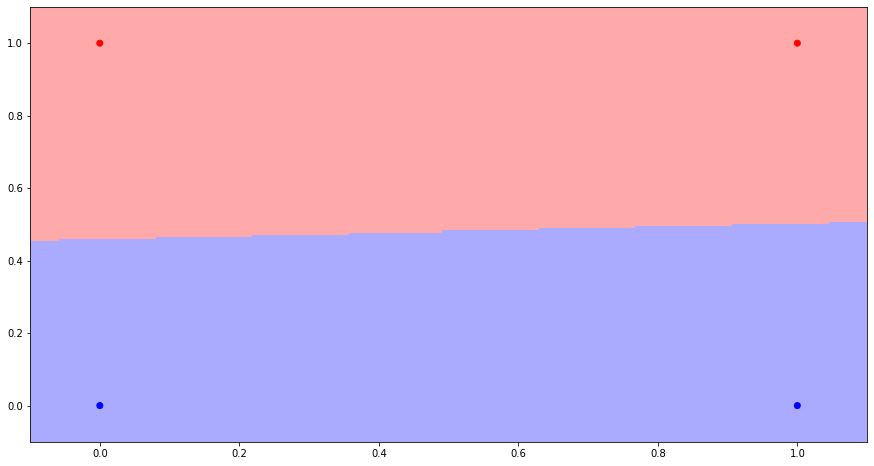

In [18]:
plot_colored_graph(model, X, y)

In [19]:
X, y = np.array([[1, 0], [1, 1], [0, 1], [0, 0]]), np.array([1, 0, 1, 0])

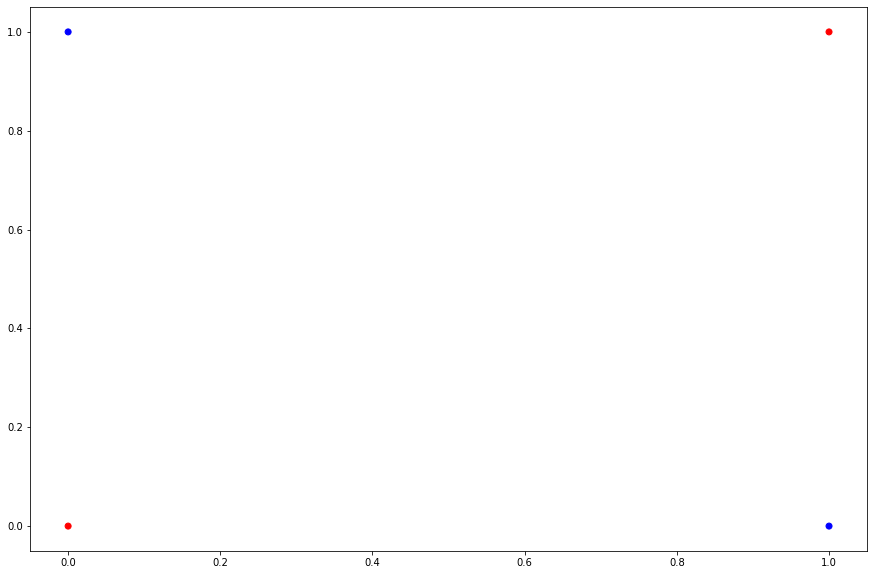

In [20]:
plot_graph(X, y)

In [21]:
model = Sequential(
    Linear(2, 8),
    ReLU(),
    Linear(8, 2),
)
optimizer = SGD(model.parameters(), lr=5e-2, momentum=0.9)
criterion = CrossEntropyLoss()

In [22]:
train_model(X, y, model, optimizer, criterion, 700)

4126 | Accuracy: 1.0
Epoch: 349 | Loss: 0.002459844305706624 | Accuracy: 1.0
Epoch: 350 | Loss: 0.0024494757777481523 | Accuracy: 1.0
Epoch: 351 | Loss: 0.002439335453284056 | Accuracy: 1.0
Epoch: 352 | Loss: 0.002429899658711762 | Accuracy: 1.0
Epoch: 353 | Loss: 0.0024202584670458627 | Accuracy: 1.0
Epoch: 354 | Loss: 0.0024106092214497997 | Accuracy: 1.0
Epoch: 355 | Loss: 0.0024008599220094315 | Accuracy: 1.0
Epoch: 356 | Loss: 0.002391263616551339 | Accuracy: 1.0
Epoch: 357 | Loss: 0.002381756885779605 | Accuracy: 1.0
Epoch: 358 | Loss: 0.00237248652071142 | Accuracy: 1.0
Epoch: 359 | Loss: 0.0023630590335737287 | Accuracy: 1.0
Epoch: 360 | Loss: 0.0023535877802887393 | Accuracy: 1.0
Epoch: 361 | Loss: 0.0023446228121030838 | Accuracy: 1.0
Epoch: 362 | Loss: 0.0023357959586420675 | Accuracy: 1.0
Epoch: 363 | Loss: 0.0023267894841640354 | Accuracy: 1.0
Epoch: 364 | Loss: 0.0023179695198524775 | Accuracy: 1.0
Epoch: 365 | Loss: 0.0023087366007241055 | Accuracy: 1.0
Epoch: 366 | Loss

<ipython-input-13-ff87a8808486>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(xx, yy, Z, cmap=cmap_light)


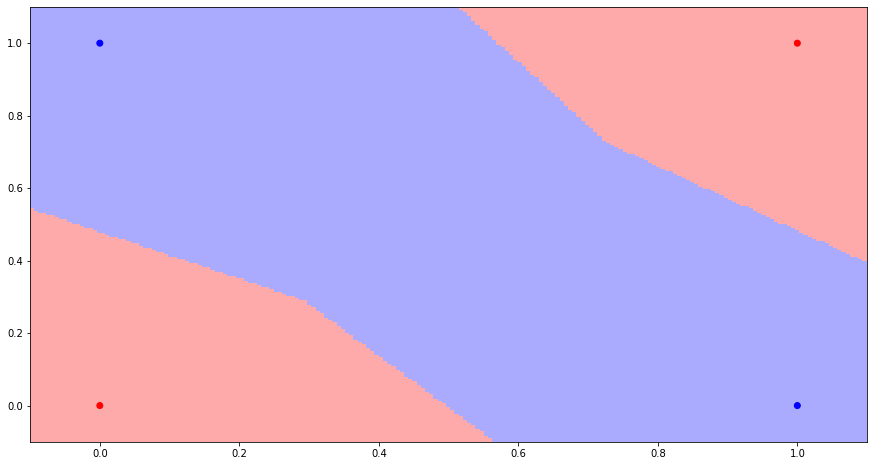

In [23]:
plot_colored_graph(model, X, y)

In [24]:
model = Sequential(
    Linear(2, 8),
    Sigmoid(),
    Linear(8, 2),
)
optimizer = SGD(model.parameters(), lr=3e-2, momentum=0.9)
criterion = CrossEntropyLoss()

In [25]:
train_model(X, y, model, optimizer, criterion, 2000)

34489999 | Accuracy: 1.0
Epoch: 1650 | Loss: 0.009245954987302678 | Accuracy: 1.0
Epoch: 1651 | Loss: 0.009236918805993151 | Accuracy: 1.0
Epoch: 1652 | Loss: 0.009227898749168845 | Accuracy: 1.0
Epoch: 1653 | Loss: 0.009218894775574 | Accuracy: 1.0
Epoch: 1654 | Loss: 0.0092099068440897 | Accuracy: 1.0
Epoch: 1655 | Loss: 0.009200934913732991 | Accuracy: 1.0
Epoch: 1656 | Loss: 0.009191978943656478 | Accuracy: 1.0
Epoch: 1657 | Loss: 0.00918303889314802 | Accuracy: 1.0
Epoch: 1658 | Loss: 0.009174114721629328 | Accuracy: 1.0
Epoch: 1659 | Loss: 0.009165206388656772 | Accuracy: 1.0
Epoch: 1660 | Loss: 0.009156313853919426 | Accuracy: 1.0
Epoch: 1661 | Loss: 0.009147437077239312 | Accuracy: 1.0
Epoch: 1662 | Loss: 0.009138576018571116 | Accuracy: 1.0
Epoch: 1663 | Loss: 0.009129730638000908 | Accuracy: 1.0
Epoch: 1664 | Loss: 0.00912090089574599 | Accuracy: 1.0
Epoch: 1665 | Loss: 0.009112086752154594 | Accuracy: 1.0
Epoch: 1666 | Loss: 0.009103288167704914 | Accuracy: 1.0
Epoch: 1667 |

<ipython-input-13-ff87a8808486>:9: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
  plt.pcolormesh(xx, yy, Z, cmap=cmap_light)


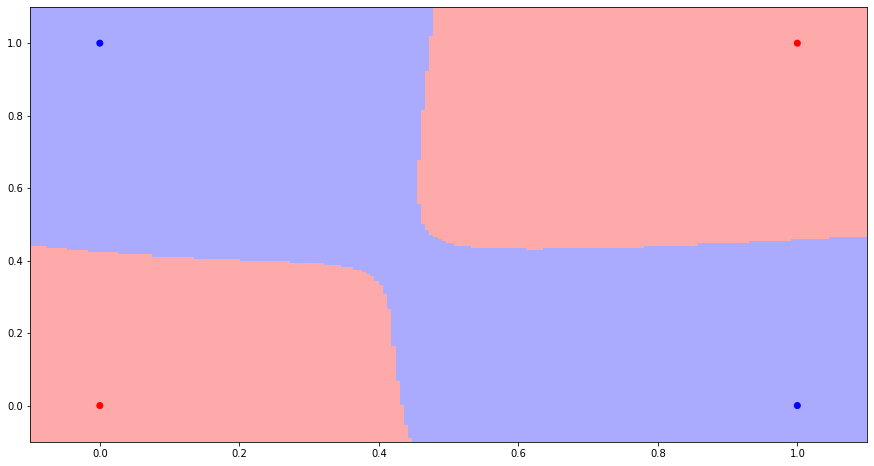

In [26]:
plot_colored_graph(model, X, y)